In [53]:
from EnsemblePursuit.EnsemblePursuit import EnsemblePursuit
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from scipy import stats 

In [2]:
rois=np.load('/media/maria/DATA1/Documents/Downl/fish04_6dpf_amph_rois.npy')

In [3]:
traces=np.load('/media/maria/DATA1/Documents/Downl/fish04_6dpf_amph_traces.npy')
print(traces.shape)

(36757, 1800)


# PCA

In [64]:
S = stats.zscore(traces, axis=1)
pcs = PCA(n_components = 100)
pcs.fit(S[:10000,:])
comps=pcs.components_

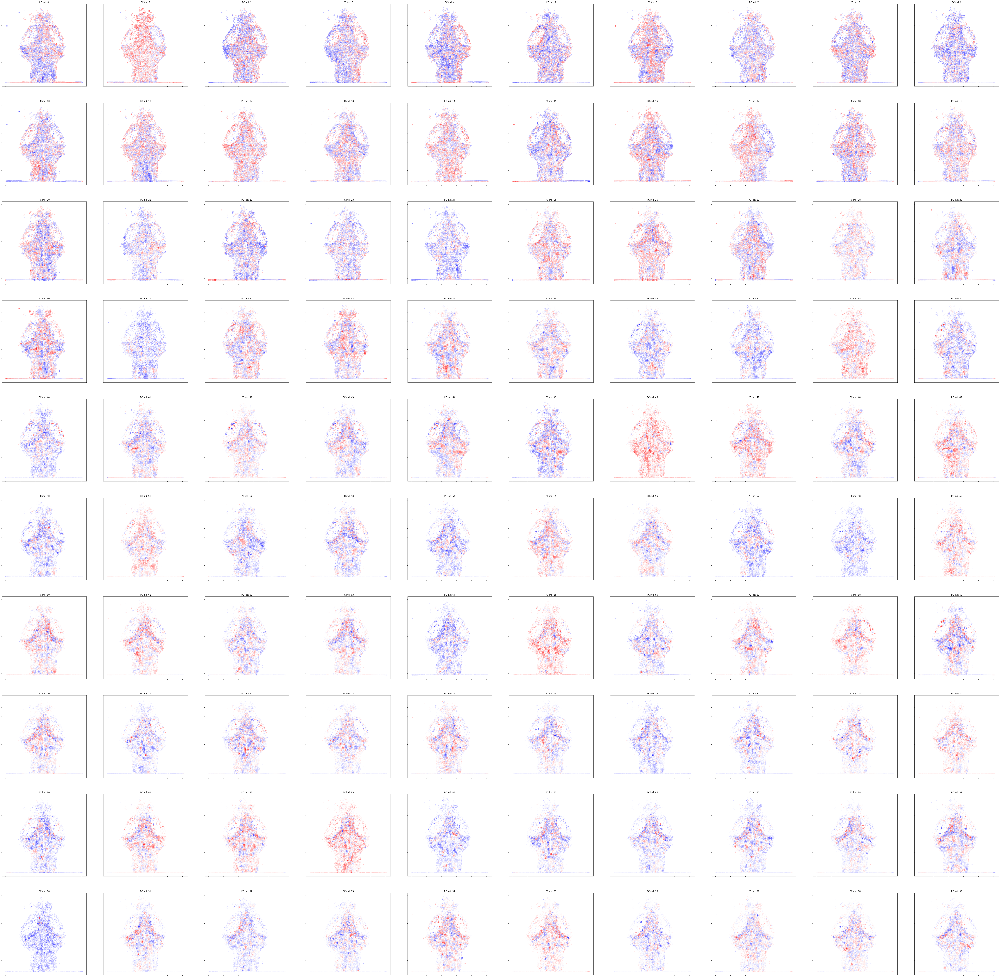

In [68]:
plt.figure(figsize=(100,100))
for j in range(100):
    pc0 = traces[:10000,:] @ comps[j,:].T
    pc0 = pc0/np.max(np.abs(pc0))
    lam = np.abs(pc0)    
    ax=plt.subplot(10,10,1+j)
    plt.scatter(x_pos, -y_pos, s = 50 * lam, c = pc0, cmap='bwr', alpha = .5)
    plt.title('PC ind: '+str(j))
    ax.set_yticklabels([])
    ax.set_xticklabels([])

# Ensemble Pursuit

In [4]:
ep=EnsemblePursuit(n_components=100,lam=0.01,n_kmeans=100)
ep.fit(traces[:10000,:].T)

obtained 100 PCs in 1.1236 seconds
initialized 100 clusters with k-means in 0.8347 seconds
ensemble 0, time 3.16, nr neurons 4964, EV 0.2009
ensemble 25, time 34.28, nr neurons 511, EV 0.7687
ensemble 50, time 40.30, nr neurons 93, EV 0.7971
ensemble 75, time 44.77, nr neurons 75, EV 0.8126
ensemble 99, time 48.30, nr neurons 102, EV 0.8226
average sparsity is 0.0737


In [6]:
print(ep.components_.shape)

(1800, 100)


In [7]:
print(rois.shape)

(36757, 4)


In [9]:
x_pos=rois[:10000,0]
y_pos=rois[:10000,1]

In [10]:
print(x_pos.shape)

(10000,)


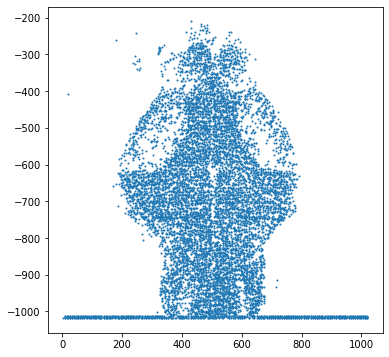

In [14]:
plt.figure(figsize=(6,6))
plt.scatter(x_pos, -y_pos, s = 1)

In [20]:
print(ep.weights.shape)

(10000, 100)


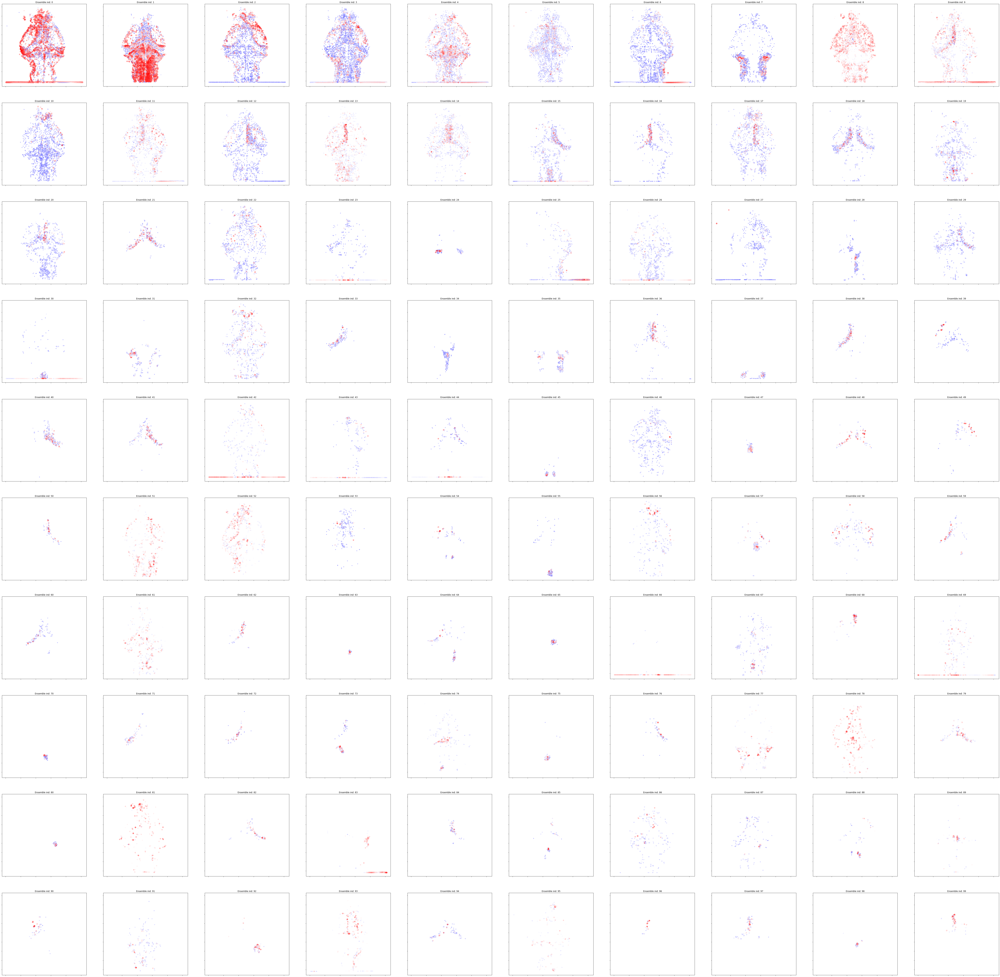

In [43]:
plt.figure(figsize=(100,100))
for ensemble in range(100):
    comp= ep.weights[:,ensemble]
    comp= comp/np.max(np.abs(comp))
    lam = np.abs(comp)    
    ax=plt.subplot(10,10,1+ensemble)
    plt.scatter(x_pos, -y_pos, s = 50 * lam, c = comp, cmap='bwr', alpha = .5)
    plt.title('Ensemble ind: '+str(ensemble))
    ax.set_yticklabels([])
    ax.set_xticklabels([])